In [1]:
import pandas as pd
from PIL import Image
import numpy as np

In [2]:
#attns = pd.read_feather('/fast/rsna-breast/tables/attn_scores_all_atomic_sweep_134.feather')
attns = pd.read_feather('/fast/rsna-breast/tables/attn_scores_all_classic_sweep_9.feather')
labels = pd.read_csv('/fast/rsna-breast/train.csv')#[['image_id','cancer']]
#top5eachImage = attns.sort_values('attention', ascending=False).groupby('imgID').head(5)
topEachImage = attns.sort_values(['imgID','attention'], ascending=False).groupby('imgID').head(10)
#topEachImage.merge(labels, left_on='imgID', right_on='image_id').cancer.value_counts()
attns=attns.merge(labels[['image_id','cancer']], left_on='imgID', right_on='image_id')

FileNotFoundError: [Errno 2] No such file or directory: '/fast/rsna-breast/tables/attn_scores_all_classic_sweep_9.feather'

In [17]:
cancer = labels[labels.cancer==1]

In [3]:
def getTile(ptID, imgID, row, col):
    fn = f'/fast/rsna-breast/tiles/224/{int(ptID)}/{int(imgID)}_{int(row)}_{int(col)}.png'
    pil = Image.open(fn)
    return pil


In [4]:
top100=attns.sort_values('attention', ascending=False).head(100)
top = top100.iloc[0]
top100

,index,ptID,imgID,row,col,attention,raw
2624501,2624501,31046,1184643445,7,7,0.995741,4.128583
2295539,2295539,27097,879741629,5,1,0.987973,3.418740
2826130,2826130,33594,525083202,5,8,0.984449,2.350915
1127642,1127642,13267,1222788247,8,2,0.982916,3.886567
5489650,5489650,65389,240295884,7,8,0.982779,3.467811
...,...,...,...,...,...,...,...
4119606,4119606,49166,1378188691,7,2,0.910230,0.836248
3102213,3102213,37035,1563009599,12,18,0.910066,2.357270
4516751,4516751,54138,1715267084,7,7,0.909784,3.189262
1021716,1021716,12153,1827516400,11,3,0.909751,2.389613


In [5]:
top100r=attns.sort_values('raw', ascending=False).head(100)
topr = top100r.iloc[0]
top100r

,index,ptID,imgID,row,col,attention,raw
564401,564401,6654,1480395667,8,4,0.657085,4.292122
2624501,2624501,31046,1184643445,7,7,0.995741,4.128583
3099861,3099861,37012,98489338,6,6,0.960056,4.070660
1127642,1127642,13267,1222788247,8,2,0.982916,3.886567
1266058,1266058,14962,1274788012,12,15,0.789131,3.855684
...,...,...,...,...,...,...,...
564394,564394,6654,1480395667,7,5,0.153172,2.835871
1712291,1712291,20365,809534962,7,7,0.305117,2.834205
3101769,3101769,37032,1291044944,7,7,0.627247,2.819063
1742464,1742464,20782,910034427,11,4,0.239390,2.815268


In [10]:
top = top100.iloc[0]
top

index        2.624501e+06
ptID         3.104600e+04
imgID        1.184643e+09
row          7.000000e+00
col          7.000000e+00
attention    9.957414e-01
raw          4.128583e+00
Name: 2624501, dtype: float64

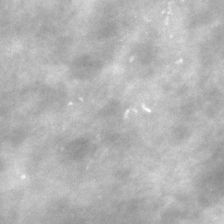

In [11]:
getTile(top.ptID, top.imgID, top.row, top.col)

In [19]:
topr.astype(int)

index            564401
ptID               6654
imgID        1480395667
row                   8
col                   4
attention             0
raw                   4
Name: 564401, dtype: int64

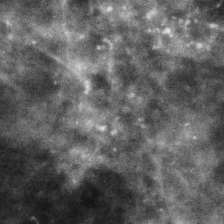

In [13]:
getTile(topr.ptID, topr.imgID, topr.row, topr.col)

In [16]:
def mosaic(ptID, imgID, row, col):
    subset = attns[attns.imgID==imgID]
    print(subset)

mosaic(topr.ptID, topr.imgID, topr.row, topr.col)

         index  ptID       imgID  row  col  attention       raw
564368  564368  6654  1480395667    3    0   0.000006 -7.397030
564369  564369  6654  1480395667    3    1   0.000037 -5.496882
564370  564370  6654  1480395667    3    2   0.000457 -2.978860
564371  564371  6654  1480395667    4    0   0.000009 -6.857161
564372  564372  6654  1480395667    4    1   0.000014 -6.479859
...        ...   ...         ...  ...  ...        ...       ...
564450  564450  6654  1480395667   14    5   0.000347 -3.254217
564451  564451  6654  1480395667   15    0   0.000024 -5.931516
564452  564452  6654  1480395667   15    1   0.000020 -6.125302
564453  564453  6654  1480395667   15    2   0.000243 -3.611014
564454  564454  6654  1480395667   15    3   0.000230 -3.663916

[87 rows x 7 columns]


In [22]:
subset = attns[attns.imgID==1480395667]
subset

,index,ptID,imgID,row,col,attention,raw
564368,564368,6654,1480395667,3,0,0.000006,-7.397030
564369,564369,6654,1480395667,3,1,0.000037,-5.496882
564370,564370,6654,1480395667,3,2,0.000457,-2.978860
564371,564371,6654,1480395667,4,0,0.000009,-6.857161
564372,564372,6654,1480395667,4,1,0.000014,-6.479859
...,...,...,...,...,...,...,...
564450,564450,6654,1480395667,14,5,0.000347,-3.254217
564451,564451,6654,1480395667,15,0,0.000024,-5.931516
564452,564452,6654,1480395667,15,1,0.000020,-6.125302
564453,564453,6654,1480395667,15,2,0.000243,-3.611014


In [23]:
subset.row.max(), subset.col.max()

(15, 8)

0.36901089549064636
0.0 1.0


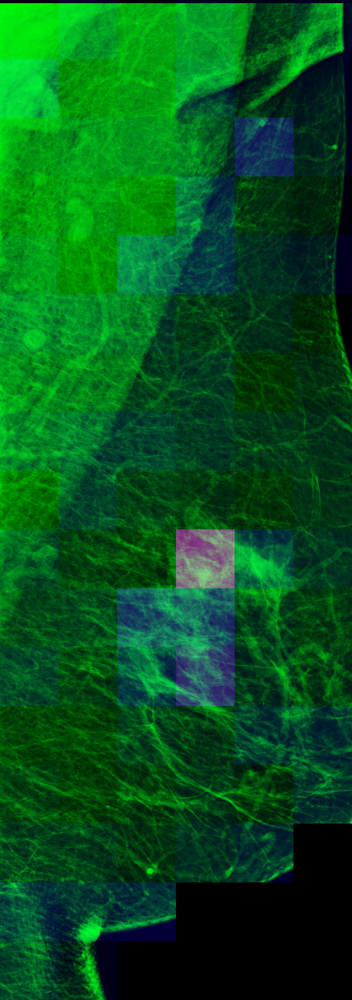

In [96]:
# dataframe implementation
# width, height
def assembleFullDF(row):
    ptID, imgID = row.patient_id, row.image_id
    #ptID, imgID = 6654, 1480395667
    subset = attns[attns.imgID==imgID].copy()
    print(subset.attention.max())
    subset['attention'] /= subset.attention.max()
    subset['attention'] *= 0.5
    subset['raw'] -= subset.raw.min()
    subset['raw'] /= subset.raw.max()
    print(subset.raw.min(), subset.raw.max())
    dst = Image.new('RGB', (224*subset.col.max(), 224*subset.row.max()))
    for rn, R in subset.iterrows():
        tile = getTile(ptID, imgID, R.row, R.col)
        tile = np.asarray(tile).copy()
        #tile[:,:,0] = int(R.attention*255)
        red = np.ones((224,224))
        red = (red*255*R.attention).astype(np.uint8)
        green = np.ones((224,224))*0.5
        green = (green*255*R.raw).astype(np.uint8)
        tile = np.dstack([red, tile, green])
        tile = Image.fromarray(tile)
        dst.paste(tile, (int(224*R.col), int(224*R.row)))
    return dst

assembleFullDF(cancer.iloc[7])

0.5527932047843933
0.0 1.0


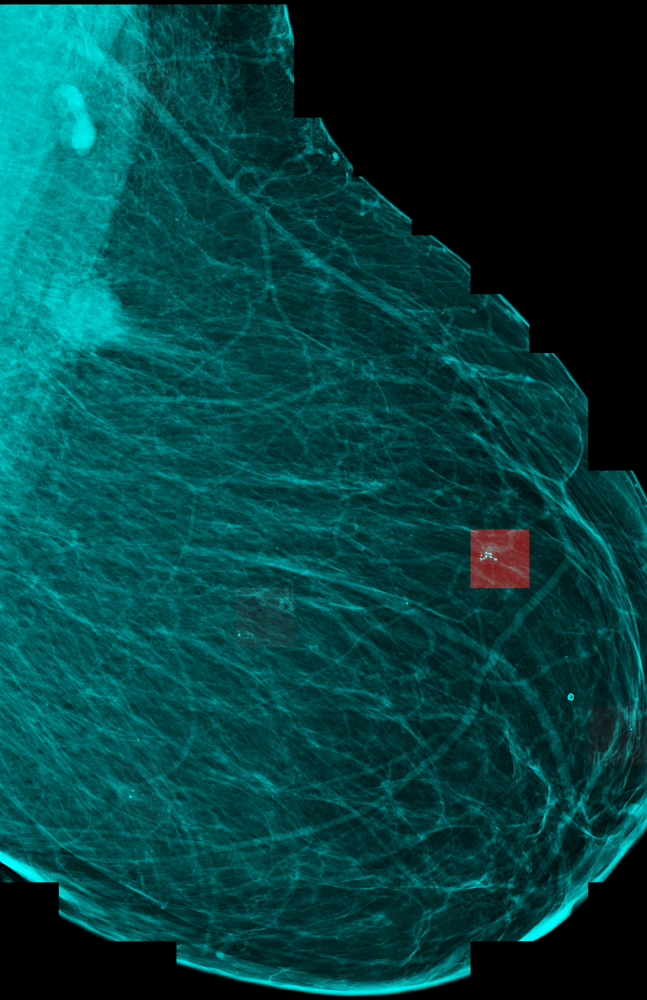

In [71]:
assembleFullDF(cancer.iloc[25])

0.9204766154289246
0.0 1.0


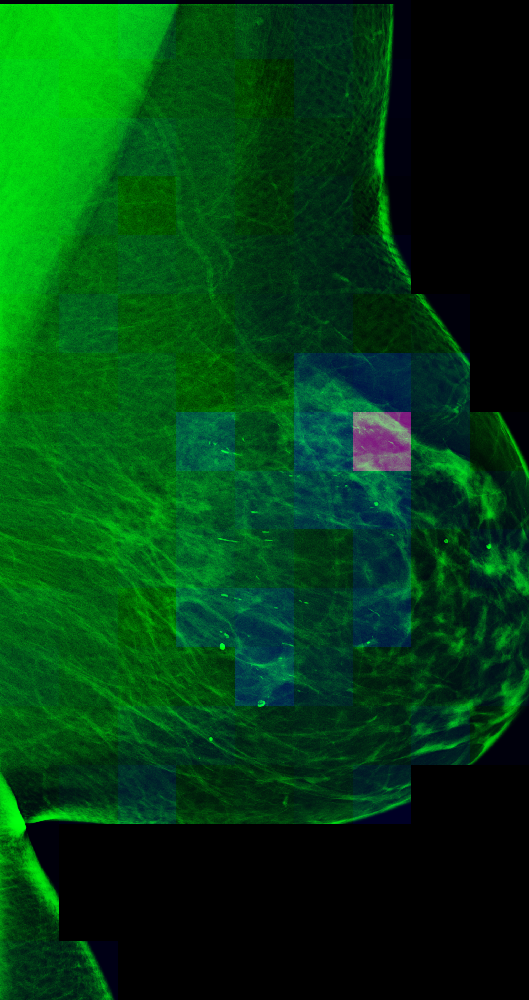

In [97]:
assembleFullDF(cancer.iloc[48])

0.39640748500823975
0.0 1.0


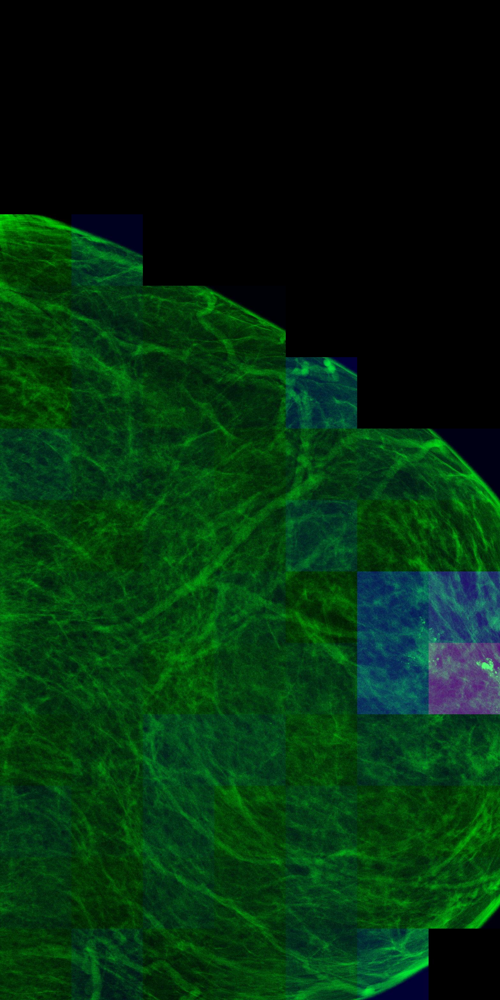

In [100]:
assembleFullDF(cancer.iloc[51])

0.7086650133132935
0.0 1.0


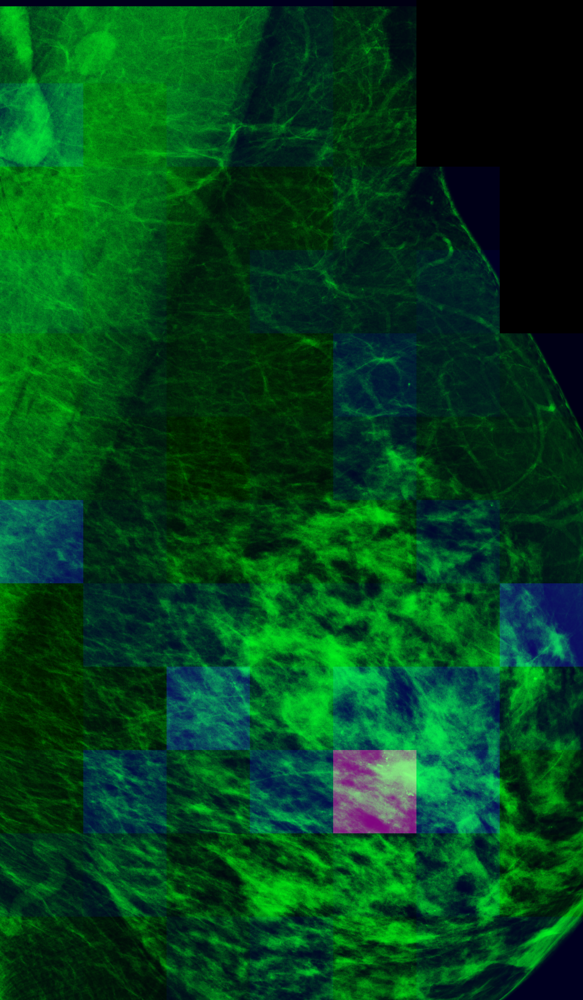

In [106]:
assembleFullDF(cancer.iloc[57])

0.5375784635543823
0.0 1.0


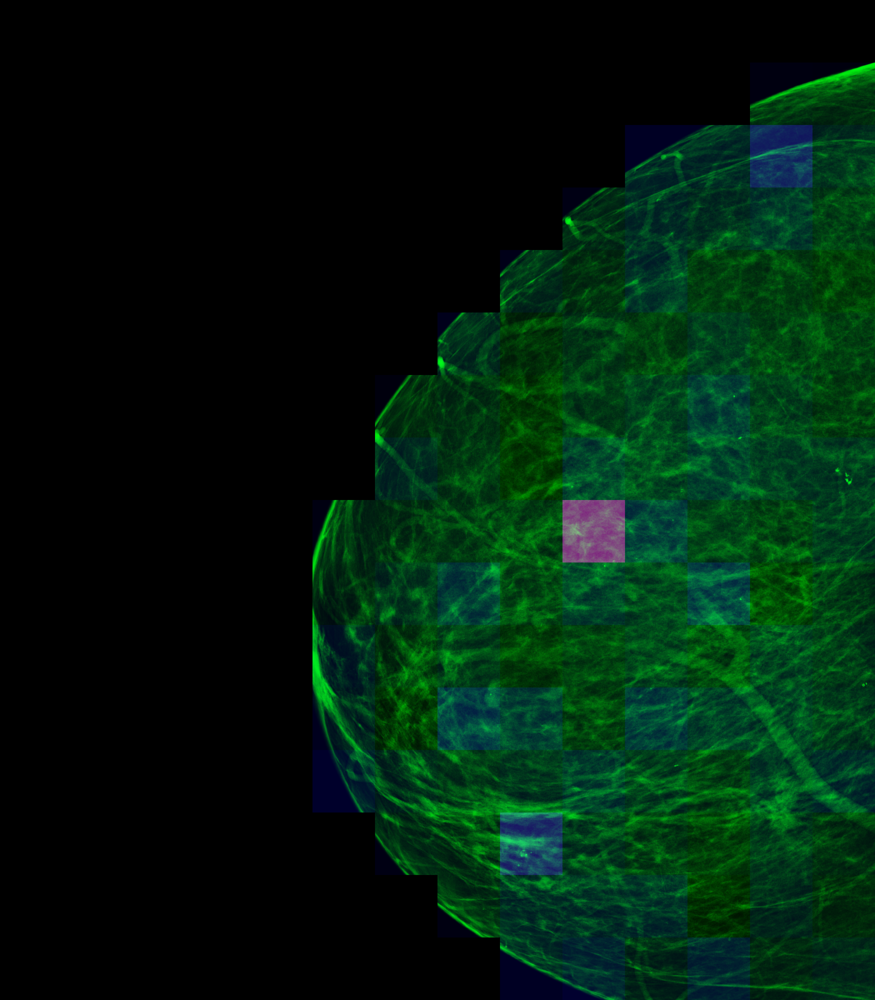

In [126]:
assembleFullDF(cancer.iloc[73])#.resize((512,768))

0.1073693111538887
0.0 1.0


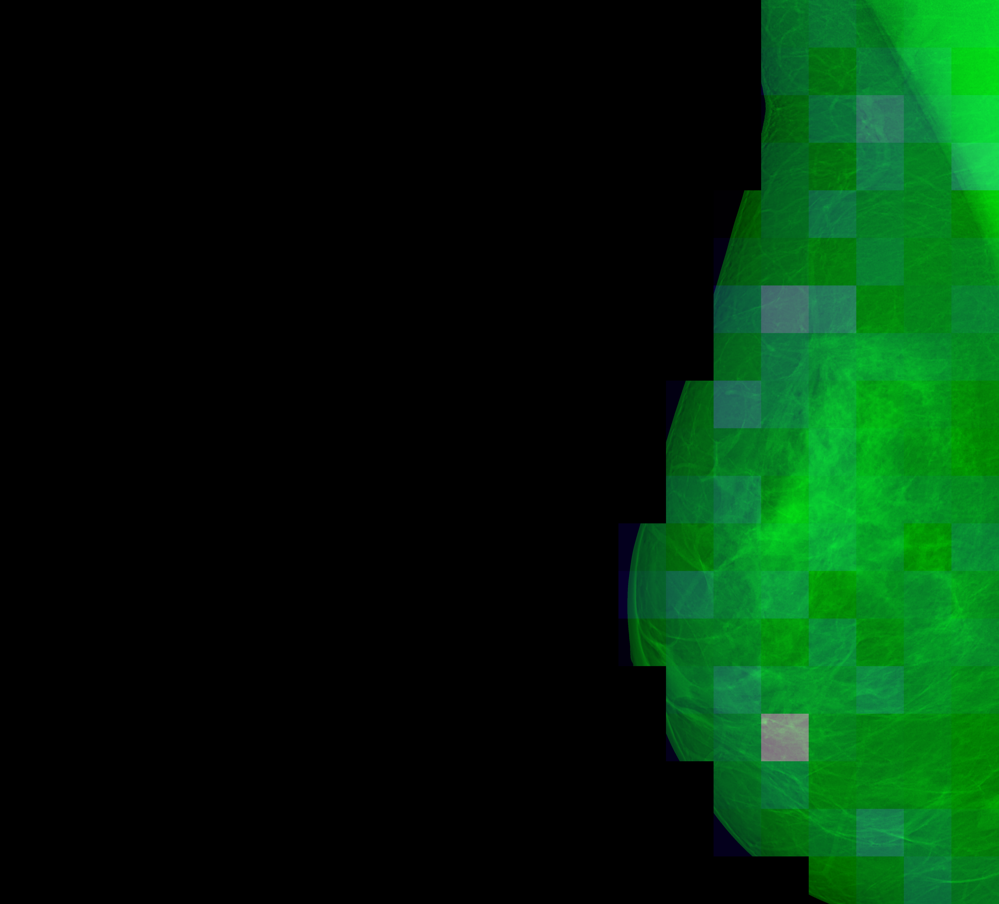

In [153]:
assembleFullDF(cancer.iloc[100])#.resize((512,768))

0.36672353744506836
0.0 1.0


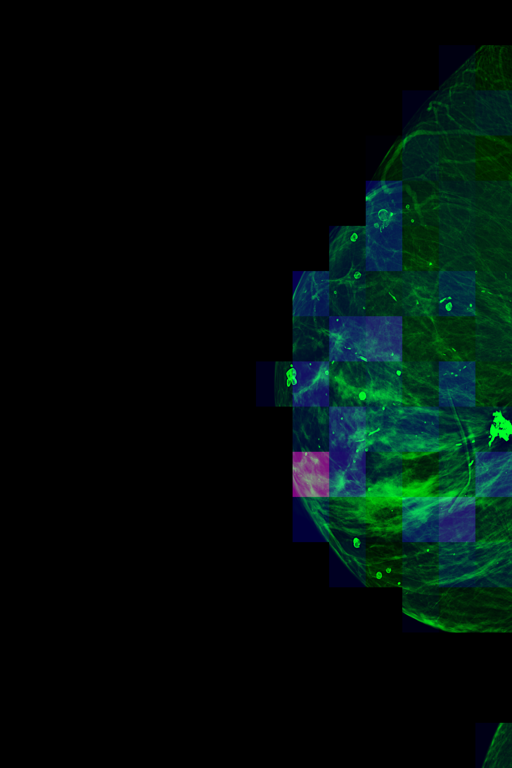

In [155]:
assembleFullDF(cancer.iloc[0]).resize((512,768))

In [12]:
cancer

,image_id,cancer
87,388811999,1
88,613462606,1
89,1360338805,1
90,1672636630,1
190,461614796,1
...,...,...
54485,1900919592,1
54593,111786935,1
54594,1559360810,1
54595,1409270544,1


In [11]:
attns.row.max(), attns.col.max()

(25, 21)

In [91]:
labels[['patient_id','image_id']].value_counts()

patient_id  image_id  
5           640805896     1
43563       1188709876    1
43564       908838343     1
            989226605     1
            1230241692    1
                         ..
21883       1480395162    1
            2086274710    1
21888       94122110      1
            461159211     1
65534       1888933323    1
Length: 54706, dtype: int64

In [127]:
# lazy filesystem implementation

from glob import glob
from PIL import Image
import os
# width, height
def assembleFull(ptID, imgID):
    #ptID, imgID = 6654, 1480395667
    pat = f'/fast/rsna-breast/newtiles/224/{ptID}/{imgID}_*_*.png'
    tiles = glob(pat)
    maxRow=0
    maxCol=0
    L = []
    for tileF in tiles:
        #print(tileF)
        _, fn = os.path.split(tileF)
        fn, _ = os.path.splitext(fn)
        _, row, col = fn.split('_')
        row, col = int(row), int(col)
        maxRow = max(maxRow, row)
        maxCol = max(maxCol, col)
        tile = Image.open(tileF)
        L.append((row, col, tile))
    dst = Image.new('RGB', (224*(maxCol+1), 224*(maxRow+1)))
    for row, col, tile in L:
        dst.paste(tile, (int(224*col), int(224*row)))
    return dst

In [5]:
cr = cancer.iloc[28]
print(cr)
assembleFull(cr.patient_id, cr.image_id)

NameError: name 'cancer' is not defined

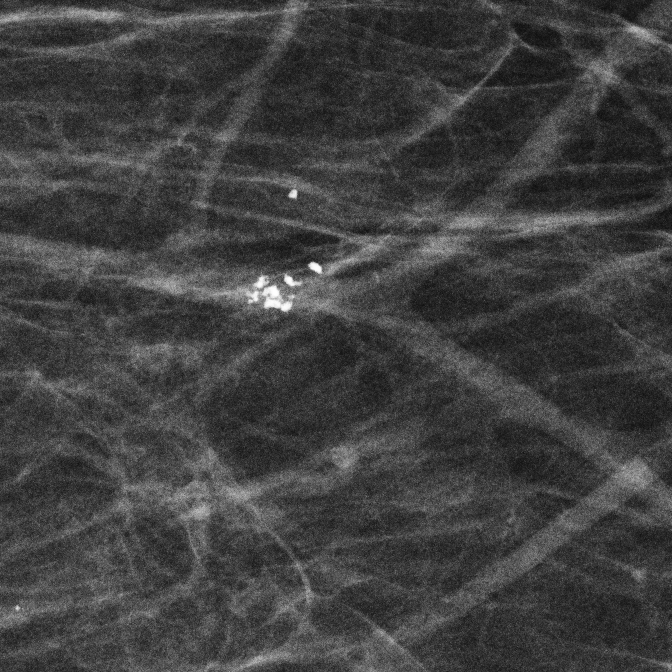

In [171]:
Rassemble(attns[attns.imgID==cr.image_id].sort_values('attention', ascending=False).iloc[1])

In [39]:
# dataframe implementation
def assembleROI(ptID, imgID, row, col):
    #ptID, imgID = 6654, 1480395667
    q = (attns.row)>row-2
    subset = attns[attns.imgID==imgID]
    dst = Image.new('RGB', (224*subset.col.max(), 224*subset.row.max()))
    for rn, R in subset.iterrows():
        tile = getTile(ptID, imgID, R.row, R.col)
        dst.paste(tile, (int(224*R.col), int(224*R.row)))
    return dst

In [4]:
# lazy filesystem implementation
def assembleROI(ptID, imgID, row, col):
    dst = Image.new('RGB', (224*3, 224*3))
    def paste(r,c):
        try:
            tile = getTile(ptID,imgID,row+r,col+c)
            dst.paste(tile, (224*(1+c), 224*(1+r)))
        except:
            print('missing')
    paste(-1,-1)
    paste(-1,0)
    paste(-1,1)

    paste(0,-1)
    paste(0,0)
    paste(0,1)

    paste(1,-1)
    paste(1,0)
    paste(1,1)

    

    return dst

#R = top100r.iloc[0]
#assembleROI(R.ptID, R.imgID, R.row, R.col)

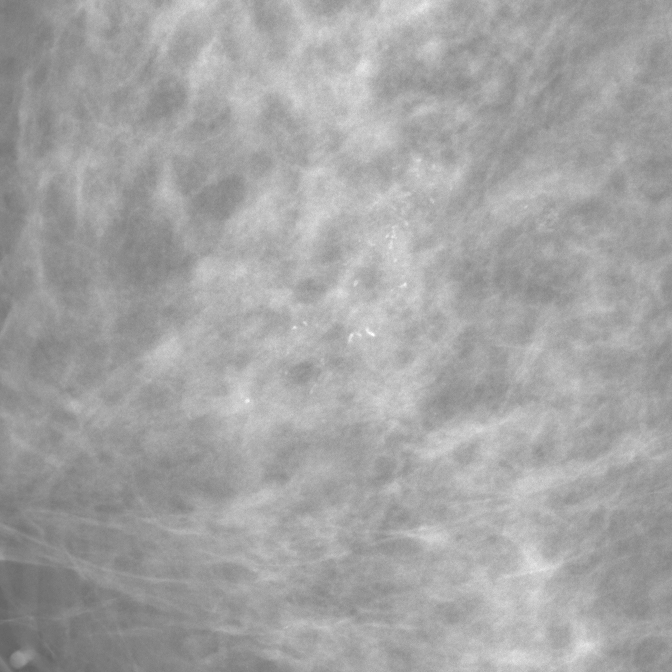

In [42]:
def Rassemble(R):
    return assembleROI(R.ptID, R.imgID, R.row, R.col)
Rassemble(top100.iloc[0])

In [57]:
Rassemble(top100.iloc[1]).size

(672, 672)

336.0

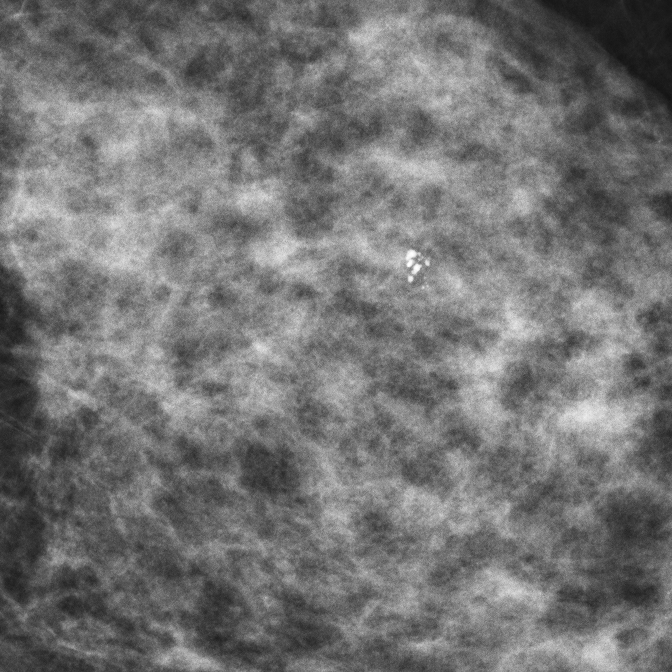

In [86]:
from torch.utils.data import Dataset

class RegionDataset(Dataset):
    def __init__(self, df, argparse):
        self.args = argparse
        self.df = df.reset_index()
        self.df = self.df.astype(int)

    def __len__(self):
        return len(self.df)

    def getTile(self, ptID, imgID, row, col):
        fn = f'/fast/rsna-breast/tiles/224/{int(ptID)}/{int(imgID)}_{int(row)}_{int(col)}.png'
        pil = Image.open(fn)
        return pil

    def assembleRegion(self, R):
        # lazy filesystem implementation
        R = R.astype(int)
        dst = Image.new('L', (224 * 3, 224 * 3))

        def paste(r, c):
            try:
                tile = self.getTile(R.ptID, R.imgID, R.row + r, R.col + c)
                dst.paste(tile, (224 * (1 + c), 224 * (1 + r)))
            except:
                print('missing')

        for r in [-1,0,1]:
            for c in [-1,0,1]:
                paste(r,c)

        return dst

    def __getitem__(self, item):
        R = self.df.iloc[item]
        regionIMG = self.assembleRegion(R)
        target = R.target
        return regionIMG, target, R.raw

top100r['target'] = 0
dataset = RegionDataset(top100r, None)
img, _, _ = dataset[19]
img

0    535368
1     11580
Name: cancer, dtype: int64

In [7]:
topEachImage.head(20)

,index,ptID,imgID,row,col,attention,raw
2996439,2996439,35693,2147471846,9,11,0.242075,-1.548560
2996417,2996417,35693,2147471846,6,10,0.091611,-2.520261
2996396,2996396,35693,2147471846,2,13,0.051672,-3.092892
2996432,2996432,35693,2147471846,8,11,0.046590,-3.196422
2996430,2996430,35693,2147471846,8,9,0.038324,-3.391727
2996406,2996406,35693,2147471846,4,11,0.026266,-3.769528
2996457,2996457,35693,2147471846,12,10,0.024499,-3.839177
2996464,2996464,35693,2147471846,13,13,0.023593,-3.876870
2996454,2996454,35693,2147471846,11,13,0.023340,-3.887639
2996447,2996447,35693,2147471846,10,12,0.020439,-4.020387


In [77]:
top5eachImage.groupby('imgID').sum()

,index,ptID,row,col,attention,raw
imgID,,,,,,
68491,12707192,149635,54,8,0.379559,-15.206228
83977,13723030,162765,49,55,0.488931,-11.799967
127964,10302013,122130,21,38,0.281511,-12.665883
193459,14417470,171625,38,51,0.375187,-14.129584
225973,4584643,54340,64,94,0.539789,-7.737457
...,...,...,...,...,...,...
2147266534,20466022,244040,50,17,0.361334,-10.533876
2147293172,3768418,44315,50,43,0.267510,-13.871235
2147355367,14588425,173870,38,21,0.314658,-14.787358


In [83]:
attns[attns.imgID==2147415608].sort_values('attention', ascending=False)

,index,ptID,imgID,row,col,attention,raw
4705654,4705654,56333,2147415608,6,5,0.145224,-2.481616
4705638,4705638,56333,2147415608,3,6,0.077389,-3.111047
4705655,4705655,56333,2147415608,6,6,0.065701,-3.274779
4705672,4705672,56333,2147415608,9,6,0.049478,-3.558372
4705661,4705661,56333,2147415608,7,6,0.047032,-3.609063
4705635,4705635,56333,2147415608,2,8,0.042418,-3.712310
4705642,4705642,56333,2147415608,4,5,0.038080,-3.820218
4705643,4705643,56333,2147415608,4,6,0.035329,-3.895195
4705671,4705671,56333,2147415608,9,5,0.029152,-4.087383
4705670,4705670,56333,2147415608,9,4,0.027519,-4.145004


In [72]:
top5eachImage.sort_values(['ptID','imgID', 'row', 'col', 'attention']).head(30)

,index,ptID,imgID,row,col,attention,raw
1,1,5,640805896,0,1,0.059486,-3.942465
9,9,5,640805896,3,0,0.061876,-3.903064
25,25,5,640805896,7,1,0.178883,-2.841472
26,26,5,640805896,7,2,0.067833,-3.811152
29,29,5,640805896,8,1,0.116155,-3.273279
39,39,5,940388076,2,8,0.471537,-2.089270
46,46,5,940388076,5,5,0.074776,-3.930763
51,51,5,940388076,6,7,0.036606,-4.645047
53,53,5,940388076,7,6,0.051368,-4.306245
57,57,5,940388076,8,8,0.058143,-4.182364


In [79]:
from torchvision import transforms as T
from torch.utils.data import Dataset
class RegionDataset(Dataset):
    def __init__(self, df, argparse=None, validation=False):
        self.args = argparse
        self.df = df.reset_index()
        self.df = self.df.astype(int)

        normalize = dict(mean=[0.5], std=[0.25])
        if validation:
            transform = [
                #T.RandomResizedCrop(size=224 * 2),
                T.CenterCrop(size=2*224)
            ]
        else:
            transform = [
                # T.RandomAffine(90.0),
                T.ColorJitter(brightness=0.25, contrast=0.25, saturation=0.25),
                T.RandomAffine(90, shear=(-20.0, 20.0), scale=(0.95, 1.05)),
                T.CenterCrop(size=2*224),
                #T.RandomResizedCrop(size=224*2),
                T.RandomHorizontalFlip(p=0.5),
                T.RandomVerticalFlip(p=0.5),
                #T.RandomApply([color_jitter], p=cj_prob),
                #T.RandomGrayscale(p=random_gray_scale),
                #GaussianBlur(
                #    kernel_size=kernel_size * input_size_,
                #    prob=gaussian_blur),
            ]

        #normalize = dict(mean=[0.5], std=[0.25])
        transform += [
            T.ToTensor(),
            T.Normalize(mean=normalize['mean'], std=normalize['std'])      # FIXME
        ]

        transform = T.Compose(transform)
        self.transform = transform


    def __len__(self):
        return len(self.df)

    def getTile(self, ptID, imgID, row, col):
        fn = f'/fast/rsna-breast/tiles/224/{int(ptID)}/{int(imgID)}_{int(row)}_{int(col)}.png'
        pil = Image.open(fn)
        return pil

    def assembleRegion(self, R):
        # lazy filesystem implementation
        R = R.astype(int)
        dst = Image.new('L', (224 * 3, 224 * 3))

        missing = 0
        def paste(r, c):
            tile = self.getTile(R.ptID, R.imgID, R.row + r, R.col + c)
            dst.paste(tile, (224 * (1 + c), 224 * (1 + r)))

        for r in [-1, 0, 1]:
            for c in [-1, 0, 1]:
                try: paste(r, c)
                except FileNotFoundError:
                    missing += 1

        print(f'missing {missing} tiles')

        return dst

    def __getitem__(self, item):
        R = self.df.iloc[item]
        regionIMG = self.assembleRegion(R)
        regionIMG = self.transform(regionIMG)
        print(type(regionIMG))
        #a = np.asarray(regionIMG)
        a = regionIMG.numpy()
        print(a.min(),a.mean(), a.max())
        target = R.target.astype(np.float32)
        return regionIMG, target, R.raw


topEachImage['target']=1
dataset = RegionDataset(topEachImage)
dataset[33][0]

missing 0 tiles
<class 'torch.Tensor'>
-1.7019608 -0.62229365 2.0


tensor([[[-1.2941, -1.2627, -1.2157,  ..., -1.2157, -1.2784, -1.2627],
         [-1.2471, -1.2471, -1.1686,  ..., -1.2784, -1.2941, -1.3569],
         [-1.2157, -1.2784, -1.2471,  ..., -1.2627, -1.2157, -1.3725],
         ...,
         [-0.8078, -0.8392, -0.5569,  ..., -0.5255, -0.3843, -0.2902],
         [-0.8549, -0.8078, -0.8078,  ..., -0.6039, -0.6196, -0.6196],
         [-0.9176, -0.8549, -0.9333,  ..., -0.3686, -0.5882, -0.4784]]])

missing 0 tiles


AttributeError: asnumpy